In [1]:
import os
os.environ["CUDA_VISIBLE_DEVICES"]="0"

import IPython.display as ipd
import pandas as pd
import numpy as np
import librosa
import torch
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
import torchaudio
import lightning
import timm
import math
import scipy.signal as signal
import torchmetrics
import wandb

from typing import Dict, Any, Optional, Callable, Union
from tqdm import tqdm
from tqdm import tqdm
from torchaudio.transforms import MelSpectrogram
from torchaudio.transforms import FrequencyMasking, TimeMasking
from torchaudio.functional import amplitude_to_DB
from sklearn.model_selection import StratifiedGroupKFold
from lightning.pytorch import loggers as pl_loggers
from lightning.pytorch.callbacks import LearningRateMonitor, ModelCheckpoint
from time import time
from audiomentations import Compose, AddGaussianNoise, TimeStretch

%matplotlib inline

# Task

For this lecture we will consider [Environmental Sound Classification 50](https://www.kaggle.com/datasets/mmoreaux/environmental-sound-classification-50?select=esc50.csv) Kaggle dataset. 

## Context 

The dataset consists in 50 WAV files sampled at 16KHz for 50 different classes.

To each one of the classes, corresponds 40 audio sample of 5 seconds each. All of these audio files have been concatenated by class in order to have 50 wave files of 3 min. 20sec.

In [2]:
# # Uncomment it to download
# !kaggle datasets download mmoreaux/environmental-sound-classification-50 --path ../../data/esc50/
# !unzip -q ../../data/esc50/environmental-sound-classification-50.zip -d ../../data/esc50/

In [3]:
DATA_ROOT = "../../data/esc50/"

# Agenda
1. [EDA](#EDA)
2. [Dataset and Dataloader](#Dataset)
3. [Metrics](#Metrics)
4. [Model](#Model)
5. [Training Module](#Training_Module)
6. [Training](#Training)
7. [Evaluation](#Evaluation)

<a id='EDA'></a>
# Exploratory Data Analysis (EDA)

In [4]:
!ls {DATA_ROOT} -lt

total 1492545
drwxr-xr-x 3 volodymyr1 users       4096 Mar 16 11:43 audio
-rw-r--r-- 1 volodymyr1 users 1528150051 Sep 21  2019 environmental-sound-classification-50.zip
-rw-r--r-- 1 volodymyr1 users       5481 Sep 21  2019 bc_utils.py
-rw-r--r-- 1 volodymyr1 users      93742 Sep 21  2019 esc50.csv
-rw-r--r-- 1 volodymyr1 users      10653 Sep 21  2019 utils.py
-rw-r--r-- 1 volodymyr1 users       8060 Sep 21  2019 utils2.py


## Meta Visualization

In [5]:
meta_df = pd.read_csv(os.path.join(DATA_ROOT,"esc50.csv"))
meta_df.head()

,filename,fold,target,category,esc10,src_file,take
0,1-100032-A-0.wav,1,0,dog,True,100032,A
1,1-100038-A-14.wav,1,14,chirping_birds,False,100038,A
2,1-100210-A-36.wav,1,36,vacuum_cleaner,False,100210,A
3,1-100210-B-36.wav,1,36,vacuum_cleaner,False,100210,B
4,1-101296-A-19.wav,1,19,thunderstorm,False,101296,A


In [6]:
meta_df["fold"].value_counts()

fold
1    400
2    400
3    400
4    400
5    400
Name: count, dtype: int64

In [7]:
meta_df["target"].value_counts()

target
0     40
39    40
29    40
10    40
7     40
26    40
6     40
44    40
23    40
20    40
49    40
24    40
28    40
14    40
18    40
2     40
35    40
38    40
21    40
1     40
11    40
42    40
5     40
33    40
40    40
12    40
43    40
27    40
36    40
19    40
30    40
34    40
9     40
22    40
48    40
41    40
47    40
31    40
17    40
45    40
8     40
15    40
46    40
37    40
32    40
16    40
25    40
4     40
3     40
13    40
Name: count, dtype: int64

In [8]:
meta_df["category"].value_counts()

category
dog                 40
glass_breaking      40
drinking_sipping    40
rain                40
insects             40
laughing            40
hen                 40
engine              40
breathing           40
crying_baby         40
hand_saw            40
coughing            40
snoring             40
chirping_birds      40
toilet_flush        40
pig                 40
washing_machine     40
clock_tick          40
sneezing            40
rooster             40
sea_waves           40
siren               40
cat                 40
door_wood_creaks    40
helicopter          40
crackling_fire      40
car_horn            40
brushing_teeth      40
vacuum_cleaner      40
thunderstorm        40
door_wood_knock     40
can_opening         40
crow                40
clapping            40
fireworks           40
chainsaw            40
airplane            40
mouse_click         40
pouring_water       40
train               40
sheep               40
water_drops         40
church_bells        40
cl

In [9]:
meta_df["take"].value_counts()

take
A    1527
B     317
C      88
D      38
E      15
F       7
G       5
H       3
Name: count, dtype: int64

In [10]:
meta_df["src_file"].value_counts()

src_file
218199    8
51805     8
160614    8
102414    7
198411    7
         ..
83536     1
83270     1
82538     1
82455     1
9032      1
Name: count, Length: 1524, dtype: int64

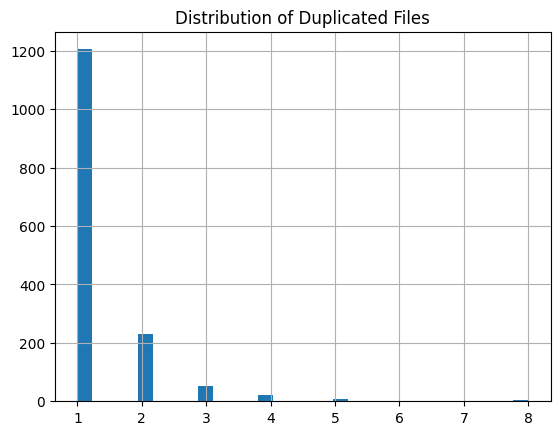

In [11]:
plt.title("Distribution of Duplicated Files")
meta_df["src_file"].value_counts().hist(bins=30)
plt.show()

### Sanity Checks

In [12]:
assert len(meta_df["filename"]) == len(set(meta_df["filename"])), "filenames are not unique"

In [13]:
class_name2idx = meta_df[["category", "target"]].drop_duplicates("target").set_index("category")["target"].to_dict()
class_idx2name = {v:k for k,v in class_name2idx.items()}

assert (meta_df["category"].map(class_name2idx) == meta_df["target"]).all(), "class mapping is invalid"

In [14]:
for fold_id in range(min(meta_df["fold"]), max(meta_df["fold"]) + 1):
    train_fold_df, val_fold_df = meta_df[meta_df["fold"] != fold_id], meta_df[meta_df["fold"] == fold_id]
    assert val_fold_df.shape[0] > 0, f"fold {fold_id} is empty"
    assert not set(val_fold_df["src_file"]) & set(train_fold_df["src_file"])

AssertionError: 

### Resplit

In [15]:
meta_df = meta_df.drop(columns=["fold"])

In [16]:
meta_df["is_train"] = True

In [17]:
skf = StratifiedGroupKFold(n_splits=10, shuffle=True, random_state=42)
for _, val_id in skf.split(meta_df, meta_df["target"], meta_df["src_file"]):
    meta_df.iloc[val_id, -1] = False
    break

In [18]:
meta_df["is_train"].value_counts(normalize=True)

is_train
True     0.908
False    0.092
Name: proportion, dtype: float64

In [19]:
assert not set(meta_df.loc[meta_df["is_train"], "src_file"]) & set(meta_df.loc[~meta_df["is_train"], "src_file"]), "Group intersection between train and test"

In [20]:
train_df, test_df = meta_df[meta_df["is_train"]].reset_index(drop=True), meta_df[~meta_df["is_train"]].reset_index(drop=True) 

In [21]:
train_df["fold"] = None

skf = StratifiedGroupKFold(n_splits=5, shuffle=True, random_state=42)
for fold_id, (_, val_id) in enumerate(skf.split(train_df, train_df["target"], train_df["src_file"])):
    train_df.iloc[val_id, -1] = fold_id

In [22]:
assert (~train_df["fold"].isna()).all(), "All Folds defined"
for fold_id in range(min(train_df["fold"]), max(train_df["fold"]) + 1):
    train_fold_df, val_fold_df = train_df[train_df["fold"] != fold_id], train_df[train_df["fold"] == fold_id]
    assert val_fold_df.shape[0] > 0, f"fold {fold_id} is empty"
    assert not set(val_fold_df["src_file"]) & set(train_fold_df["src_file"])

In [23]:
print("Test Target Distribution")
test_df["category"].value_counts()

Test Target Distribution


category
train               9
can_opening         8
sneezing            7
coughing            7
clapping            6
clock_alarm         6
hen                 6
pouring_water       6
crickets            6
car_horn            5
airplane            5
church_bells        5
sea_waves           5
pig                 5
clock_tick          5
wind                5
keyboard_typing     5
glass_breaking      5
hand_saw            5
dog                 4
chainsaw            4
insects             4
rain                4
laughing            4
siren               3
toilet_flush        3
cat                 3
engine              3
door_wood_creaks    3
chirping_birds      3
breathing           3
snoring             3
crying_baby         3
door_wood_knock     3
frog                2
helicopter          2
brushing_teeth      2
vacuum_cleaner      2
water_drops         2
mouse_click         2
sheep               2
crow                2
crackling_fire      1
cow                 1
drinking_sipping    1
r

In [24]:
for fold_id in range(min(train_df["fold"]), max(train_df["fold"]) + 1):
    val_fold_df = train_df[train_df["fold"] == fold_id]
    print(f"Fold {fold_id} Target Distribution")
    print(val_fold_df["category"].value_counts())

Fold 0 Target Distribution
category
hand_saw            16
pouring_water       12
clock_tick          11
fireworks           11
snoring             11
chainsaw            11
vacuum_cleaner      11
rain                11
thunderstorm        11
footsteps           10
chirping_birds      10
drinking_sipping    10
coughing            10
helicopter           9
glass_breaking       9
sneezing             9
siren                9
cat                  9
rooster              8
breathing            8
dog                  8
crickets             8
cow                  8
crackling_fire       8
wind                 8
washing_machine      7
hen                  7
clock_alarm          7
train                6
church_bells         6
crow                 6
airplane             6
sea_waves            6
sheep                6
can_opening          6
car_horn             5
insects              5
clapping             5
brushing_teeth       5
water_drops          5
door_wood_knock      5
laughing             

## Audio Meta

In [25]:
!ls {os.path.join(DATA_ROOT, "audio/audio")} | head

1-100032-A-0.wav
1-100038-A-14.wav
1-100210-A-36.wav
1-100210-B-36.wav
1-101296-A-19.wav
1-101296-B-19.wav
1-101336-A-30.wav
1-101404-A-34.wav
1-103298-A-9.wav
1-103995-A-30.wav
ls: write error: Broken pipe


In [26]:
!ls {os.path.join(DATA_ROOT, "audio/audio/44100")} | head

1-100032-A-0.wav
1-100038-A-14.wav
1-100210-A-36.wav
1-100210-B-36.wav
1-101296-A-19.wav
1-101296-B-19.wav
1-101336-A-30.wav
1-101404-A-34.wav
1-103298-A-9.wav
1-103995-A-30.wav
ls: write error: Broken pipe


In [27]:
def enrich_df_with_filepaths(input_df):
    input_df["filepath"] = input_df["filename"].apply(lambda x: os.path.join(DATA_ROOT, "audio/audio", x))
    input_df["filepath_hq"] = input_df["filename"].apply(lambda x: os.path.join(DATA_ROOT, "audio/audio/44100", x))

    assert input_df["filepath"].apply(os.path.exists).all()
    assert input_df["filepath_hq"].apply(os.path.exists).all()
    
    return input_df

In [28]:
train_df = enrich_df_with_filepaths(train_df)
test_df = enrich_df_with_filepaths(test_df)

In [29]:
def get_audio_metadata(file_path: str):
    """
    Extract metadata from an audio file using torchaudio.
    
    Args:
        file_path (str): Path to the audio file.
    
    Returns:
        dict: Metadata containing sample rate, duration, channels, bit depth, and encoding format.
    """
    # Get basic metadata
    metadata = torchaudio.info(file_path)
    
    # Extract key information
    sample_rate = metadata.sample_rate
    num_channels = metadata.num_channels
    num_frames = metadata.num_frames
    duration = num_frames / sample_rate if sample_rate else None
    
    # Additional metadata (if available)
    bit_depth = getattr(metadata, "bits_per_sample", None)  # Only available for certain formats
    encoding = getattr(metadata, "encoding", None)  # Available for some formats
    
    return {
        "sample_rate": sample_rate,
        "duration": duration,
        "num_channels": num_channels,
        "bit_depth": bit_depth,
        "encoding": encoding,
    }

In [30]:
# It looks like we have the same files in "audio/audio" and "audio/audio/44100". At least according to meta

filepath_meta = pd.DataFrame(train_df["filepath"].apply(get_audio_metadata).to_list())
filepath_hq_meta = pd.DataFrame(train_df["filepath_hq"].apply(get_audio_metadata).to_list())

for column in filepath_meta.columns:
    print((filepath_meta[column] == filepath_hq_meta[column]).all())

True
True
True
True
True


In [31]:
def enrich_df_with_audiometa(input_df):
    return pd.concat([
        input_df,
        pd.DataFrame(input_df["filepath"].apply(get_audio_metadata).to_list())
    ], axis=1)

In [32]:
train_df = enrich_df_with_audiometa(train_df)
test_df = enrich_df_with_audiometa(test_df)

In [33]:
train_df["sample_rate"].value_counts()

sample_rate
44100    1816
Name: count, dtype: int64

In [34]:
train_df["duration"].value_counts()

duration
5.0    1816
Name: count, dtype: int64

In [35]:
train_df["num_channels"].value_counts()

num_channels
1    1816
Name: count, dtype: int64

In [36]:
train_df["bit_depth"].value_counts()

bit_depth
16    1816
Name: count, dtype: int64

In [37]:
train_df["encoding"].value_counts()

encoding
PCM_S    1816
Name: count, dtype: int64

## Audio Files

In [38]:
# Original code from https://www.kaggle.com/code/mmoreaux/esc50-visualization and modified with Chat GPT

def plot_audio_spectrograms(file_paths, class_names):
    """
    Plots the spectrograms and waveforms of given audio files using their native sample rates.
    
    Args:
        file_paths (list of str): List of paths to audio files.
        class_names (list of str): List of corresponding class names.
    """
    num_files = len(file_paths)
    num_cols = 5  # Number of columns
    num_rows = math.ceil(num_files / num_cols) * 2  # Each audio takes 2 rows (spectrogram + waveform)

    fig, axs = plt.subplots(num_rows, num_cols, figsize=(13, num_rows * 2))

    if num_rows == 2:
        axs = np.reshape(axs, (num_rows, num_cols))  # Ensure correct indexing for small cases

    for idx, file_path in enumerate(file_paths):
        try:
            # Load audio with native sample rate
            waveform, sample_rate = torchaudio.load(file_path)
            waveform = waveform.numpy().T  # Convert to NumPy and transpose for compatibility

            # Compute spectrogram
            sampleFreqs, segmentTimes, sxx = signal.spectrogram(waveform[:, 0], sample_rate)

            # Determine row and column indices
            i, j = (idx // num_cols) * 2, idx % num_cols  # Spectrogram in row i, waveform in i+1

            # Plot spectrogram
            axs[i][j].pcolormesh((len(segmentTimes) * segmentTimes / segmentTimes[-1]),
                                 sampleFreqs,
                                 10 * np.log10(sxx + 1e-15))
            axs[i][j].set_title(f"{class_names[idx]}", fontsize=10)
            axs[i][j].set_axis_off()

            # Plot waveform
            axs[i + 1][j].plot(waveform)
            axs[i + 1][j].set_axis_off()

        except Exception as e:
            print(f"Error processing {file_path}: {e}")

    plt.tight_layout()
    plt.show()

    # Play audio
    for idx, file_path in enumerate(file_paths):
        try:
            waveform, sample_rate = torchaudio.load(file_path)
            waveform = waveform.numpy().T
            print(f"Playing: {class_names[idx]}")
            ipd.display(ipd.Audio(waveform[:, 0], rate=sample_rate))
        except Exception as e:
            print(f"Error playing {file_path}: {e}")

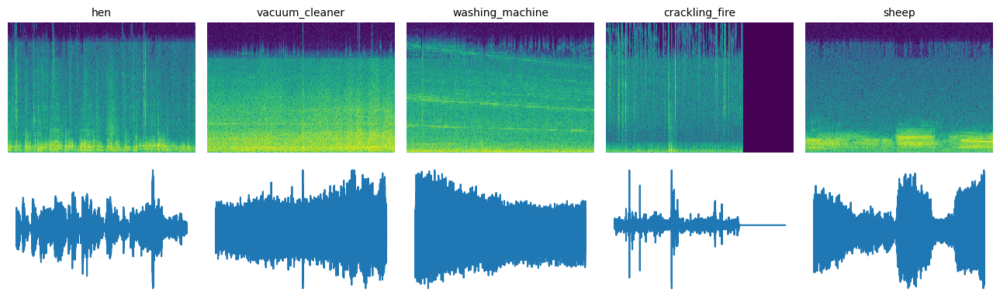

Playing: hen


Playing: vacuum_cleaner


Playing: washing_machine


Playing: crackling_fire


Playing: sheep


In [39]:
sample_idxs = np.random.randint(0, len(train_df), size=5)

plot_audio_spectrograms(
    train_df["filepath"].iloc[sample_idxs].to_list(),
    train_df["category"].iloc[sample_idxs].to_list()
)

In [40]:
train_df[train_df["src_file"] == 218199]

,filename,target,category,esc10,src_file,take,is_train,fold,filepath,filepath_hq,sample_rate,duration,num_channels,bit_depth,encoding
1410,4-218199-A-35.wav,35,washing_machine,False,218199,A,True,1,../../data/esc50/audio/audio/4-218199-A-35.wav,../../data/esc50/audio/audio/44100/4-218199-A-...,44100,5.0,1,16,PCM_S
1411,4-218199-B-35.wav,35,washing_machine,False,218199,B,True,1,../../data/esc50/audio/audio/4-218199-B-35.wav,../../data/esc50/audio/audio/44100/4-218199-B-...,44100,5.0,1,16,PCM_S
1412,4-218199-C-35.wav,35,washing_machine,False,218199,C,True,1,../../data/esc50/audio/audio/4-218199-C-35.wav,../../data/esc50/audio/audio/44100/4-218199-C-...,44100,5.0,1,16,PCM_S
1413,4-218199-D-35.wav,35,washing_machine,False,218199,D,True,1,../../data/esc50/audio/audio/4-218199-D-35.wav,../../data/esc50/audio/audio/44100/4-218199-D-...,44100,5.0,1,16,PCM_S
1414,4-218199-E-35.wav,35,washing_machine,False,218199,E,True,1,../../data/esc50/audio/audio/4-218199-E-35.wav,../../data/esc50/audio/audio/44100/4-218199-E-...,44100,5.0,1,16,PCM_S
1415,4-218199-F-35.wav,35,washing_machine,False,218199,F,True,1,../../data/esc50/audio/audio/4-218199-F-35.wav,../../data/esc50/audio/audio/44100/4-218199-F-...,44100,5.0,1,16,PCM_S
1416,4-218199-G-35.wav,35,washing_machine,False,218199,G,True,1,../../data/esc50/audio/audio/4-218199-G-35.wav,../../data/esc50/audio/audio/44100/4-218199-G-...,44100,5.0,1,16,PCM_S
1417,4-218199-H-35.wav,35,washing_machine,False,218199,H,True,1,../../data/esc50/audio/audio/4-218199-H-35.wav,../../data/esc50/audio/audio/44100/4-218199-H-...,44100,5.0,1,16,PCM_S


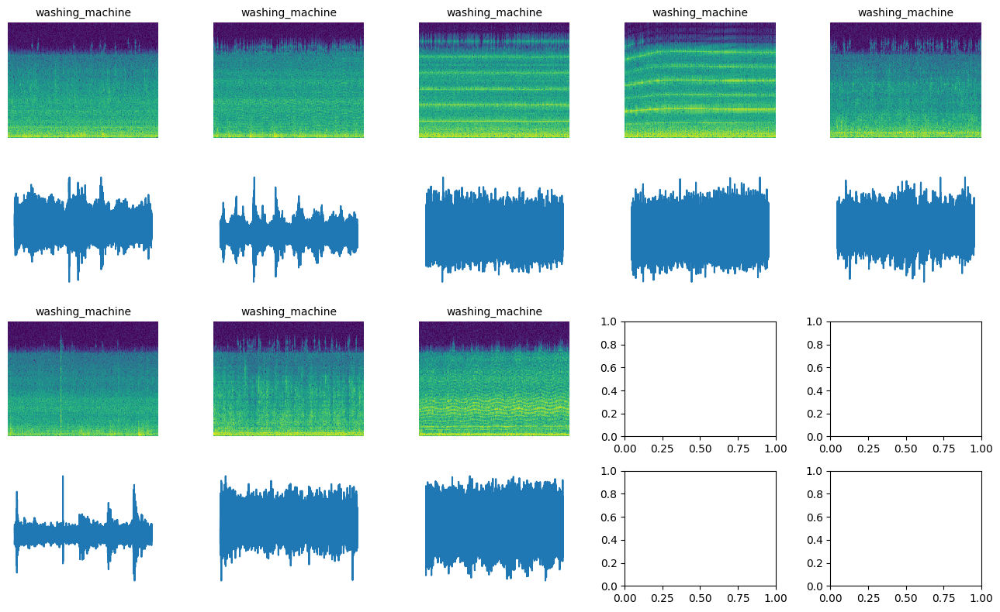

Playing: washing_machine


Playing: washing_machine


Playing: washing_machine


Playing: washing_machine


Playing: washing_machine


Playing: washing_machine


Playing: washing_machine


Playing: washing_machine


In [41]:
plot_audio_spectrograms(
    train_df.loc[train_df["src_file"] == 218199, "filepath"].to_list(),
    train_df.loc[train_df["src_file"] == 218199, "category"].to_list()
)

<a id='Dataset'></a>
# Dataset and Dataloader

In [42]:
def plot_wave_spectrograms(waveforms, sample_rate, class_names, num_cols=2, specs=None):
    """
    Plots the spectrograms and waveforms of given audio waveforms using a shared sample rate.
    
    Args:
        waveforms (list of np.ndarray): List of audio waveforms (NumPy arrays of shape [samples, channels]).
        sample_rate (int): Common sample rate for all waveforms.
        class_names (list of str): List of corresponding class names.
        num_cols (int): Number of columns in the plot layout. Default is 2.
        specs (list of np.ndarray, optional): List of precomputed spectrograms (2D tensors, only `sxx` values).
                                              If None, spectrograms will be computed automatically.
    """
    num_files = len(waveforms)
    num_rows = math.ceil(num_files / num_cols) * 2  # Each audio takes 2 rows (spectrogram + waveform)

    fig, axs = plt.subplots(num_rows, num_cols, figsize=(num_cols * 2.6, num_rows * 2))

    if num_rows == 2:
        axs = np.reshape(axs, (num_rows, num_cols))  # Ensure correct indexing for small cases

    for idx, (waveform, class_name) in enumerate(zip(waveforms, class_names)):

        # Determine row and column indices
        i, j = (idx // num_cols) * 2, idx % num_cols  # Spectrogram in row i, waveform in i+1
        
        # Compute spectrogram if not provided
        if specs is None:
            sampleFreqs, segmentTimes, sxx = signal.spectrogram(waveform, sample_rate)

            # Plot spectrogram
            axs[i][j].pcolormesh(segmentTimes, sampleFreqs, 10 * np.log10(sxx + 1e-15))
            axs[i][j].set_title(f"{class_name}", fontsize=10)
            axs[i][j].set_axis_off()
        else:
            # Plot spectrogram
            axs[i][j].imshow(specs[idx])
            axs[i][j].set_title(f"{class_name}", fontsize=10)
            axs[i][j].set_axis_off()

        # Plot waveform
        axs[i + 1][j].plot(waveform)
        axs[i + 1][j].set_axis_off()

    plt.tight_layout()
    plt.show()

    # Play audio
    for waveform, class_name in zip(waveforms, class_names):
        print(f"Playing: {class_name}")
        ipd.display(ipd.Audio(waveform, rate=sample_rate))


In [43]:
class AudioDataset(torch.utils.data.Dataset):
    def __init__(
        self,
        input_df,
        filenpath_col="filepath",
        target_col="target",
        sample_rate=16000,
        normalize_audio=True,
        audio_transforms=None,
    ):        
        self.df = input_df.reset_index(drop=True)

        self.filenpath_col = filenpath_col
        self.target_col = target_col

        self.sample_rate = sample_rate
        self.normalize_audio = normalize_audio

        self.audio_transforms = audio_transforms

    def __len__(self):
        return len(self.df)

    def _prepare_sample(self, idx: int):
        au, sr = librosa.load(self.df[self.filenpath_col].iloc[idx], sr=self.sample_rate)
        assert sr == self.sample_rate
        # We know that all samples are of the same length = 5 sec and contains only one channel
        assert len(au.shape) == 1
        assert au.shape[0] == self.sample_rate * 5

        target_idx = self.df[self.target_col].iloc[idx]

        if self.audio_transforms is not None:
            au = self.audio_transforms(samples=au, sample_rate=sr)

        if self.normalize_audio:
            au = librosa.util.normalize(au)

        return torch.from_numpy(au).float(), target_idx

    def __getitem__(self, idx: int):
        return self._prepare_sample(idx)

> <font color='red'>**TODO**</font>: Implement MixUp directrly in `AudioDataset`.

In [44]:
testing_dataset = AudioDataset(
    input_df=train_df,
    sample_rate=32000
)
testing_dataset_with_augs = AudioDataset(
    input_df=train_df,
    sample_rate=32000,
    audio_transforms=Compose([
        AddGaussianNoise(min_amplitude=0.005, max_amplitude=0.01, p=0.5),
        TimeStretch(min_rate=0.8, max_rate=1.2, p=0.5),
    ])
)

In [47]:
check_idx = np.random.randint(len(testing_dataset))

au, cls_id = testing_dataset[check_idx]
au_aug, _ = testing_dataset_with_augs[check_idx]

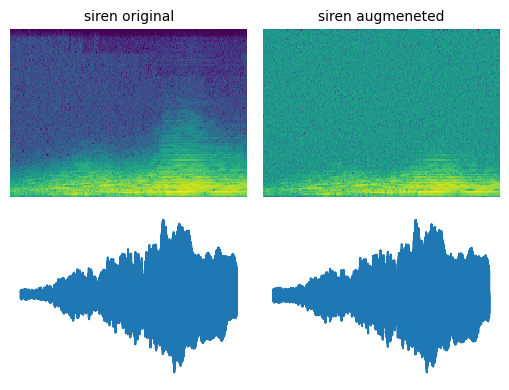

Playing: siren original


Playing: siren augmeneted


In [48]:
plot_wave_spectrograms(
    [au.numpy(), au_aug.numpy()],
    32000,
    [class_idx2name[cls_id] + " original", class_idx2name[cls_id] + " augmeneted"]
)

In [49]:
testing_dataloader = torch.utils.data.DataLoader(
    testing_dataset,
    batch_size=6,
    shuffle=True,
    drop_last=True,
    num_workers=8,
    pin_memory=True
)
for batch in testing_dataloader:
    break
    
print(
    "Audio Batch Shape:", batch[0].shape,
    "\nTarget Batch Shape:", batch[1].shape,
)

Audio Batch Shape: torch.Size([6, 160000]) 
Target Batch Shape: torch.Size([6])


<a id='Metrics'></a>
# Metrics

We will use [torchmetrics](https://lightning.ai/docs/torchmetrics/stable/)

In [51]:
audioset_metric_collection = torchmetrics.MetricCollection(
    metrics=[
        torchmetrics.Accuracy(average="macro", task="multiclass", num_classes=len(class_name2idx)),
        torchmetrics.Recall(average="macro", task="multiclass", num_classes=len(class_name2idx)),
        torchmetrics.Precision(average="macro", task="multiclass", num_classes=len(class_name2idx)),
        torchmetrics.F1Score(average="macro", task="multiclass", num_classes=len(class_name2idx)),
    ],
    compute_groups=False
)

In [52]:
audioset_metric_collection.forward(batch[1], batch[1])

{'MulticlassAccuracy': tensor(1.),
 'MulticlassRecall': tensor(1.),
 'MulticlassPrecision': tensor(1.),
 'MulticlassF1Score': tensor(1.)}

In [53]:
audioset_metric_collection.forward(
    torch.randint_like(batch[1], high=len(class_name2idx)), 
    batch[1]
)

{'MulticlassAccuracy': tensor(0.),
 'MulticlassRecall': tensor(0.),
 'MulticlassPrecision': tensor(0.),
 'MulticlassF1Score': tensor(0.)}

<a id='Model'></a>
# Model

We will use CNN based approach and build next Pipeline:
1. Normalization Layer.
2. (Optional) Augmentation Layer.
3. CNN Encoder.
4. Pooling Layer.
5. Classification Layer.

Something near the architecture, which I have used on [BirdCLEF 2023](https://www.kaggle.com/competitions/birdclef-2023/discussion/412808).

![nn_arch](images/audio_nn_arch.png)

As CNN backbone we will use [EfficientNet](https://arxiv.org/abs/1905.11946) family with pretrains from [timm repo](https://github.com/huggingface/pytorch-image-models).

> **TODO**: Try other CNN architecture "families".

In [55]:
class NormalizeMelSpec(nn.Module):
    def __init__(
        self, 
        eps=1e-6, 
        normalize_standart=True,
        normalize_minmax=True,
    ):
        super().__init__()
        self.eps = eps
        self.normalize_standart = normalize_standart
        self.normalize_minmax = normalize_minmax

    def forward(self, X):
        if self.normalize_standart:
            # X shape: (..., frequencies, time)
            mean = X.mean((-2, -1), keepdim=True)
            std = X.std((-2, -1), keepdim=True)
            X = (X - mean) / (std + self.eps)
        if self.normalize_minmax:
            norm_max = torch.amax(X, dim=(-2, -1), keepdim=True)
            norm_min = torch.amin(X, dim=(-2, -1), keepdim=True)
            X = (X - norm_min) / (norm_max - norm_min + self.eps)
            return X

class CustomMasking(nn.Module):
    def __init__(self, mask_max_length: int, mask_max_masks: int, p=1.0, inplace=True):
        super().__init__()
        assert isinstance(mask_max_masks, int) and mask_max_masks > 0
        self.mask_max_masks = mask_max_masks
        self.mask_max_length = mask_max_length
        self.mask_module = None
        self.p = p
        self.inplace = inplace

    def forward(self, x):
        if not self.inplace:
            output = x.clone()
        for i in range(x.shape[0]):
            if np.random.binomial(n=1, p=self.p):
                n_applies = np.random.randint(low=1, high=self.mask_max_masks + 1)
                for _ in range(n_applies):
                    if self.inplace:
                        x[i : i + 1] = self.mask_module(x[i : i + 1])
                    else:
                        output[i : i + 1] = self.mask_module(output[i : i + 1])
        if self.inplace:
            return x
        else:
            return output


class CustomTimeMasking(CustomMasking):
    def __init__(self, mask_max_length: int, mask_max_masks: int, p=1.0, inplace=True):
        super().__init__(mask_max_length=mask_max_length, mask_max_masks=mask_max_masks, p=p, inplace=inplace)
        self.mask_module = TimeMasking(time_mask_param=mask_max_length)


class CustomFreqMasking(CustomMasking):
    def __init__(self, mask_max_length: int, mask_max_masks: int, p=1.0, inplace=True):
        super().__init__(mask_max_length=mask_max_length, mask_max_masks=mask_max_masks, p=p, inplace=inplace)
        self.mask_module = FrequencyMasking(freq_mask_param=mask_max_length)

class ChannelAgnosticAmplitudeToDB(nn.Module):
    r"""Turn a tensor from the power/amplitude scale to the decibel scale.
    Modified version of torchaudio.transfroms.AmplitudeToDB, that treats first dimension as batch, not as channels for 3D tensors.

    .. devices:: CPU CUDA

    .. properties:: Autograd TorchScript

    This output depends on the maximum value in the input tensor, and so
    may return different values for an audio clip split into snippets vs. a
    a full clip.

    Args:
        stype (str, optional): scale of input tensor (``"power"`` or ``"magnitude"``). The
            power being the elementwise square of the magnitude. (Default: ``"power"``)
        top_db (float or None, optional): minimum negative cut-off in decibels.  A reasonable
            number is 80. (Default: ``None``)

    Example
        >>> waveform, sample_rate = torchaudio.load("test.wav", normalize=True)
        >>> transform = ChannelAgnosticAmplitudeToDB(stype="amplitude", top_db=80)
        >>> waveform_db = transform(waveform)
    """
    __constants__ = ["multiplier", "amin", "ref_value", "db_multiplier"]

    def __init__(self, stype: str = "power", top_db: Optional[float] = None) -> None:
        super(ChannelAgnosticAmplitudeToDB, self).__init__()
        self.stype = stype
        if top_db is not None and top_db < 0:
            raise ValueError("top_db must be positive value")
        self.top_db = top_db
        self.multiplier = 10.0 if stype == "power" else 20.0
        self.amin = 1e-10
        self.ref_value = 1.0
        self.db_multiplier = math.log10(max(self.amin, self.ref_value))

    def forward(self, x: torch.Tensor) -> torch.Tensor:
        r"""Numerically stable implementation from Librosa.

        https://librosa.org/doc/latest/generated/librosa.amplitude_to_db.html

        Args:
            x (Tensor): Input tensor before being converted to decibel scale.

        Returns:
            Tensor: Output tensor in decibel scale.
        """
        assert x.dim() in [3, 4], f"Expected 3D or 4D tensor, but got {x.dim()}D tensor"

        add_fake_channel = False
        if x.dim() == 3:
            x = x.unsqueeze(1)
            add_fake_channel = True

        x_db = amplitude_to_DB(x, self.multiplier, self.amin, self.db_multiplier, self.top_db)

        if add_fake_channel:
            x_db = x_db.squeeze(1)
        return x_db

class SpecCNNClasifier(nn.Module):
    def __init__(
        self,
        backbone: str,
        device: str,
        n_classes: int,
        classifier_dropout: float = 0.5,
        spec_paramms: Dict[str, Any] = {
            "sample_rate": 32000,
            "n_mels": 128,
            "f_min": 20,
            "n_fft": 1024,
            "hop_length": 512,
            "normalized": True,
        },
        top_db: float = 80.0,
        normalize_config: Dict[str, bool] = {
            "normalize_standart": True,
            "normalize_minmax": True,
        },
        pretrained: bool = True,
        timm_kwargs: Optional[Dict] = None,
        spec_augment_config: Optional[Dict[str, Any]] = None,
    ):
        super().__init__()
        timm_kwargs = {} if timm_kwargs is None else timm_kwargs
        self.device = device

        self.spectogram_extractor = nn.Sequential(
            MelSpectrogram(**spec_paramms),
            ChannelAgnosticAmplitudeToDB(top_db=top_db),
            NormalizeMelSpec(**normalize_config),
        )
        
        if spec_augment_config is not None:
            self.spec_augment = []
            if "freq_mask" in spec_augment_config:
                self.spec_augment.append(CustomFreqMasking(**spec_augment_config["freq_mask"]))
            if "time_mask" in spec_augment_config:
                self.spec_augment.append(CustomTimeMasking(**spec_augment_config["time_mask"]))
            self.spec_augment = nn.Sequential(*self.spec_augment)
        else:
            self.spec_augment = None

        
        self.backbone = timm.create_model(
            backbone,
            features_only=True,
            pretrained=pretrained,
            in_chans=1,
            exportable=True,
            **timm_kwargs,
        )

        self.pool = nn.AdaptiveAvgPool2d((1, 1))
        self.classifier = nn.Sequential(
            nn.Dropout(p=classifier_dropout),
            nn.Linear(self.backbone.feature_info.channels()[-1], n_classes),
        )
        
        self.to(self.device)

    def forward(self, input, return_spec_feature=False, return_cnn_emb=False):
        specs = self.spectogram_extractor(input)
        if self.spec_augment is not None and self.training:
            specs = self.spec_augment(specs)
        if return_spec_feature:
            return specs

        # Add Channel Dimension
        emb = self.backbone(specs.unsqueeze(1))[-1]
        if return_cnn_emb:
            return emb

        bs, ch, h, w = emb.shape
        emb = self.pool(emb)
        emb = emb.view(bs, ch)

        logits = self.classifier(emb)

        return {"logits": logits}

> <font color='red'>**TODO**</font>: Implement and use GeM Pooling.

In [56]:
testing_model = SpecCNNClasifier(
    backbone="tf_efficientnet_b0.in1k",
    device="cpu",
    n_classes=len(class_idx2name),
    spec_paramms={
        "sample_rate": 32000,
        "n_mels": 128,
        "f_min": 20,
        "n_fft": 1024,
        "hop_length": 512,
        "normalized": True, 
    },
    top_db=80.0,
    normalize_config={
        "normalize_standart": True,
        "normalize_minmax": True,
    },
    pretrained=True
)

Unexpected keys (bn2.bias, bn2.num_batches_tracked, bn2.running_mean, bn2.running_var, bn2.weight, classifier.bias, classifier.weight, conv_head.weight) found while loading pretrained weights. This may be expected if model is being adapted.


Original input audios:

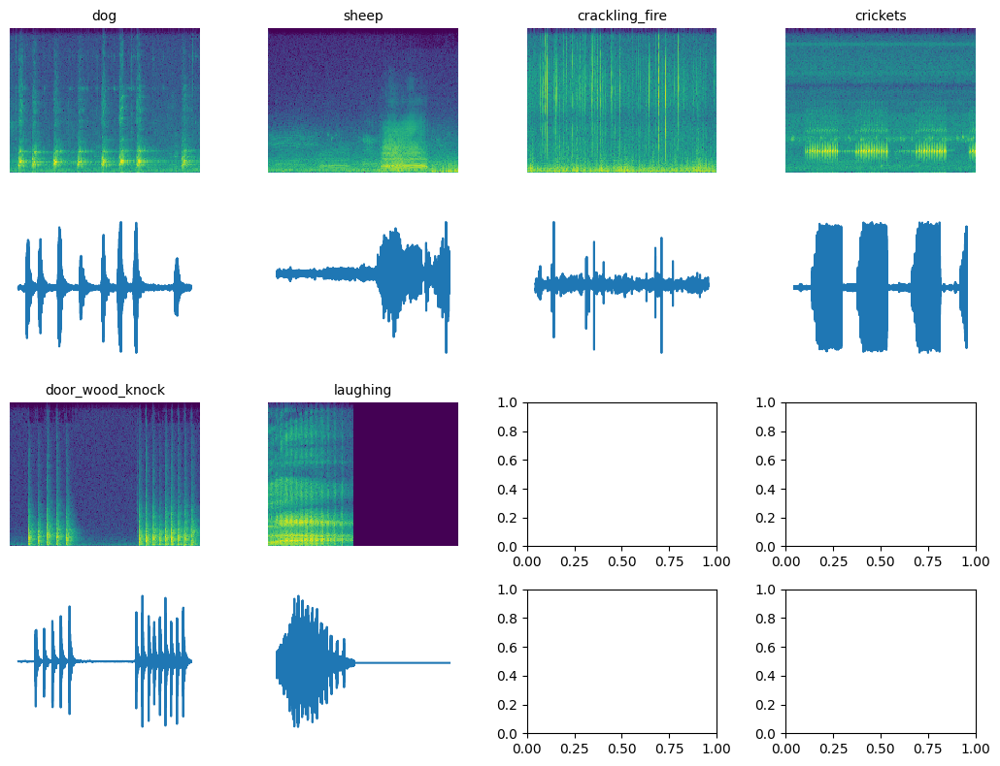

Playing: dog


Playing: sheep


Playing: crackling_fire


Playing: crickets


Playing: door_wood_knock


Playing: laughing


In [57]:
plot_wave_spectrograms(
    batch[0],
    32000,
    [class_idx2name[el.item()] for el in batch[1]],
    num_cols=4
)

Extracted Spectograms:

In [58]:
nn_specs = testing_model.forward(batch[0], return_spec_feature=True)

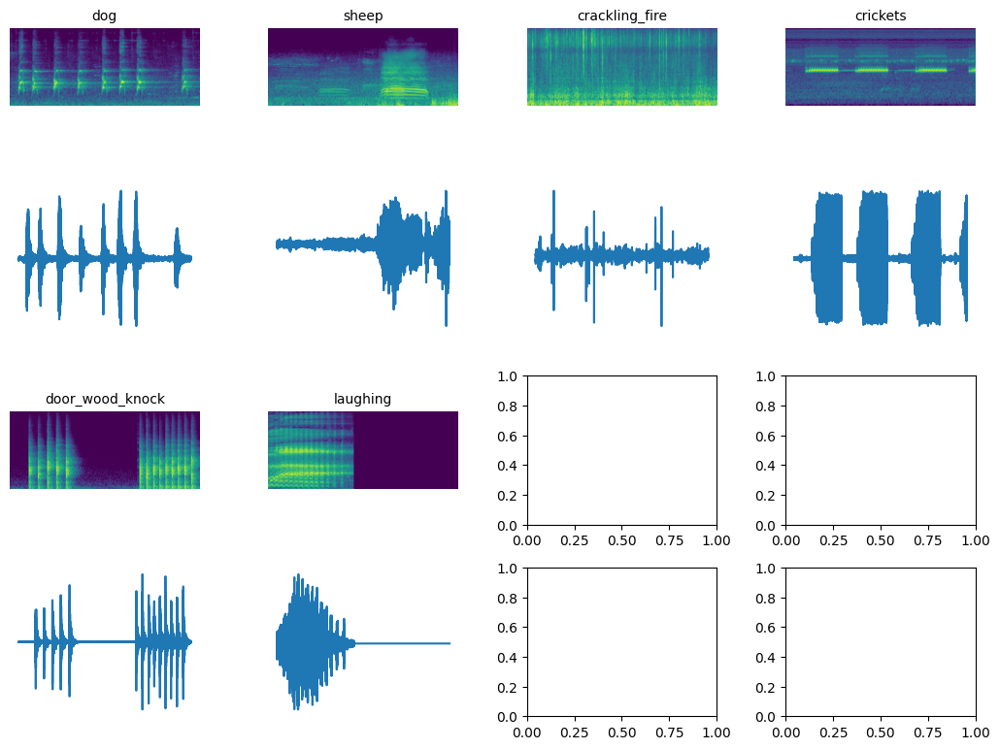

Playing: dog


Playing: sheep


Playing: crackling_fire


Playing: crickets


Playing: door_wood_knock


Playing: laughing


In [59]:
plot_wave_spectrograms(
    batch[0],
    32000,
    [class_idx2name[el.item()] for el in batch[1]],
    num_cols=4,
    specs=[torch.flip(spec, (0,)) for spec in nn_specs]
)

Extracted + Augmneted Spectograms:

In [60]:
testing_model = SpecCNNClasifier(
    backbone="tf_efficientnet_b0.in1k",
    device="cpu",
    n_classes=len(class_idx2name),
    spec_paramms={
        "sample_rate": 32000,
        "n_mels": 128,
        "f_min": 20,
        "n_fft": 1024,
        "hop_length": 512,
        "normalized": True, 
    },
    top_db=80.0,
    normalize_config={
        "normalize_standart": True,
        "normalize_minmax": True,
    },
    pretrained=True,
    spec_augment_config={
        "freq_mask": {
            "mask_max_length": 20,
            "mask_max_masks": 5,
            "p": 1.0,
            "inplace": True,
        },
        "time_mask": {
            "mask_max_length": 30,
            "mask_max_masks": 5,
            "p": 1.0,
            "inplace": True,
        },
    }
)

Unexpected keys (bn2.bias, bn2.num_batches_tracked, bn2.running_mean, bn2.running_var, bn2.weight, classifier.bias, classifier.weight, conv_head.weight) found while loading pretrained weights. This may be expected if model is being adapted.


In [61]:
nn_specs = testing_model.forward(batch[0], return_spec_feature=True)

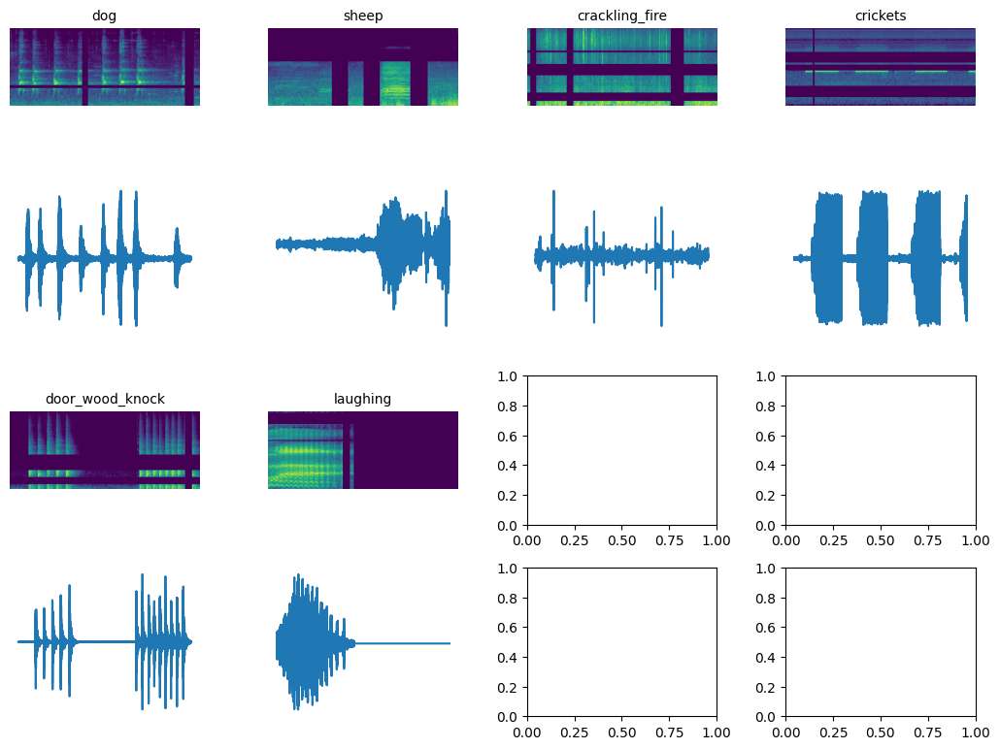

Playing: dog


Playing: sheep


Playing: crackling_fire


Playing: crickets


Playing: door_wood_knock


Playing: laughing


In [62]:
plot_wave_spectrograms(
    batch[0],
    32000,
    [class_idx2name[el.item()] for el in batch[1]],
    num_cols=4,
    specs=[torch.flip(spec, (0,)) for spec in nn_specs]
)

Extracted + Augmneted Spectograms -> CNN Encoder:

In [63]:
with torch.no_grad():
    cnn_embed = testing_model(
        batch[0],
        return_cnn_emb=True
    ).detach().cpu()

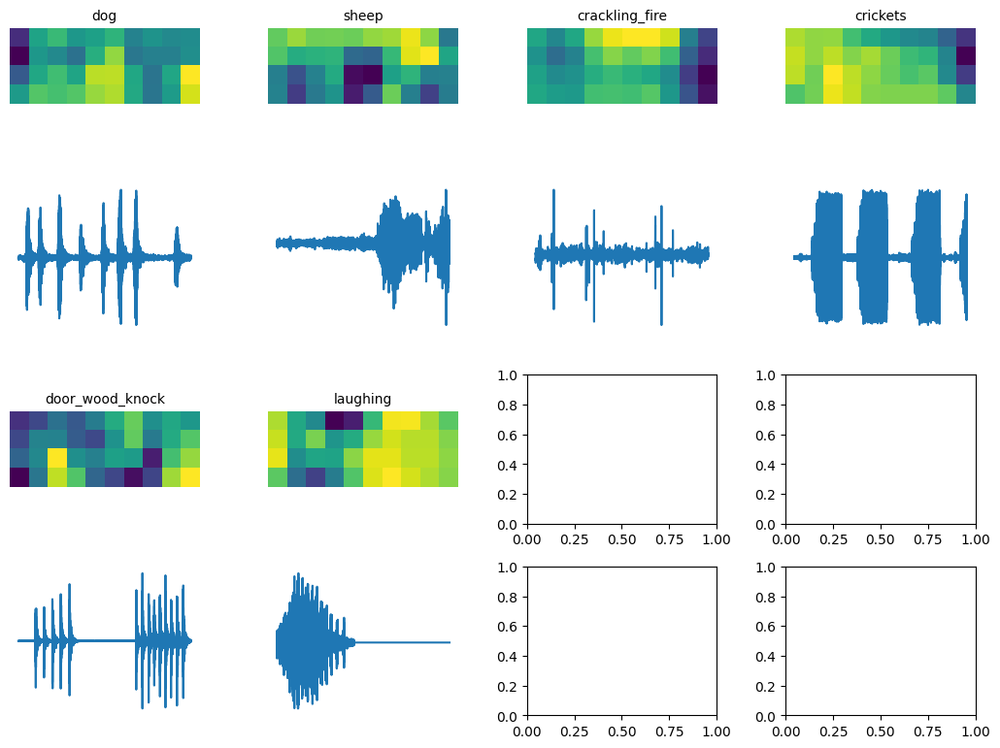

Playing: dog


Playing: sheep


Playing: crackling_fire


Playing: crickets


Playing: door_wood_knock


Playing: laughing


In [64]:
plot_wave_spectrograms(
    batch[0],
    32000,
    [class_idx2name[el.item()] for el in batch[1]],
    num_cols=4,
    specs=[torch.flip(embed[embed.shape[0] // 2], (0,)) for embed in cnn_embed]
)

Extracted + Augmneted Spectograms -> CNN Encoder -> Linear:

In [65]:
with torch.no_grad():
    logits = testing_model(
        batch[0]
    )

logits

{'logits': tensor([[-0.6183,  2.4300,  1.0912, -0.1519,  1.9375,  0.5358, -0.6845, -1.8883,
          -0.4047,  0.4295,  0.9144,  0.7789,  0.8550,  1.0867, -2.4170,  0.1033,
          -1.1620, -1.6413,  0.0099,  0.1561, -1.8410,  0.4008, -0.4543,  2.1511,
           0.9827, -0.4202,  0.1642,  1.7150,  0.4305,  0.1488, -0.9487,  0.0990,
           0.8420, -1.2769, -0.5409,  0.2479, -0.9449, -1.3073, -0.1564,  0.3704,
           0.7425,  1.3831, -0.2035,  0.5734,  0.6390, -0.9500, -0.3950,  0.5033,
           0.5379, -0.4994],
         [-0.1334,  0.5773, -0.5239,  0.5335,  1.9529,  1.2341,  0.3854,  1.1553,
           0.0975,  0.7112, -0.6528,  0.1811, -0.9661,  0.8063, -0.2610,  0.1765,
           0.6909,  0.0425,  0.4360, -0.6313, -0.5475, -0.7764,  0.1292, -0.2207,
           0.4263,  0.3089,  0.2758, -0.4101,  1.1149, -0.0874,  0.8561,  0.2061,
           0.8295,  0.7685,  0.1210,  0.1416,  0.2161, -0.1665,  0.4548, -0.4326,
           0.3037, -1.2896,  0.2221, -0.1698,  0.7432, -0.2

<a id='Training_Module'></a>
# Training Module

In [66]:
class LitTrainer(lightning.LightningModule):
    def __init__(
        self,
        model,
        forward,
        optimizer,
        scheduler,
        scheduler_params,
        batch_key,
        metric_input_key,
        metric_output_key,
        val_metrics,
        train_metrics=None,
    ):
        super().__init__()

        self.model = model
        self._forward = forward
        self._optimizer = optimizer
        self._scheduler = scheduler
        self._scheduler_params = scheduler_params
        self._batch_key = batch_key

        self._metric_input_key = metric_input_key
        self._metric_output_key = metric_output_key
        self._val_metrics = val_metrics
        self._train_metrics = train_metrics

    def _aggregate_outputs(self, losses, inputs, outputs):
        united = losses
        united.update({"input_" + k: v for k, v in inputs.items()})
        united.update({"output_" + k: v for k, v in outputs.items()})
        return united

    def training_step(self, batch):

        start_time = time()
        losses, inputs, outputs = self._forward(self, batch, epoch=self.current_epoch)
        model_time = time() - start_time

        if self._train_metrics is not None:
            self._train_metrics.update(
                outputs[self._metric_output_key],
                inputs[self._metric_input_key]
            )

        for k, v in losses.items():
            self.log(
                "train_" + k,
                v,
                on_step=True,
                on_epoch=False,
                prog_bar=True,
                logger=True,
                batch_size=inputs[self._batch_key].shape[0],
                sync_dist=True,
            )
            self.log(
                "train_avg_" + k,
                v,
                on_step=False,
                on_epoch=True,
                prog_bar=True,
                logger=True,
                batch_size=inputs[self._batch_key].shape[0],
                sync_dist=True,
            )
        self.log(
            "train_model_time",
            model_time,
            on_step=True,
            on_epoch=False,
            prog_bar=True,
            logger=True,
            batch_size=1,
            sync_dist=True,
        )
        self.log(
            "train_avg_model_time",
            model_time,
            on_step=False,
            on_epoch=True,
            prog_bar=True,
            logger=True,
            batch_size=1,
            sync_dist=True,
        )

        return self._aggregate_outputs(losses, inputs, outputs)

    def validation_step(self, batch, batch_idx):

        start_time = time()
        losses, inputs, outputs = self._forward(self, batch, epoch=self.current_epoch)
        model_time = time() - start_time

        if self._val_metrics is not None:
            self._val_metrics.update(
                outputs[self._metric_output_key],
                inputs[self._metric_input_key]
            )

        for k, v in losses.items():
            self.log(
                "valid_" + k,
                v,
                on_step=True,
                on_epoch=False,
                prog_bar=True,
                logger=True,
                batch_size=inputs[self._batch_key].shape[0],
                sync_dist=True,
            )
            self.log(
                "valid_avg_" + k,
                v,
                on_step=False,
                on_epoch=True,
                prog_bar=True,
                logger=True,
                batch_size=inputs[self._batch_key].shape[0],
                sync_dist=True,
            )
        self.log(
            "valid_model_time",
            model_time,
            on_step=True,
            on_epoch=False,
            prog_bar=True,
            logger=True,
            batch_size=1,
            sync_dist=True,
        )
        self.log(
            "valid_avg_model_time",
            model_time,
            on_step=False,
            on_epoch=True,
            prog_bar=True,
            logger=True,
            batch_size=1,
            sync_dist=True,
        )

        return self._aggregate_outputs(losses, inputs, outputs)

    def on_train_epoch_end(self):
        metric_values = self._train_metrics.compute()
        self.log_dict(
            {"train_"+k:v for k,v in metric_values.items()},
            on_step=False,
            on_epoch=True,
            prog_bar=False,
            sync_dist=True,
        )
        self._train_metrics.reset()

    def on_validation_epoch_end(self):
        metric_values = self._val_metrics.compute()
        self.log_dict(
            {"valid_"+k:v for k,v in metric_values.items()},
            on_step=False,
            on_epoch=True,
            prog_bar=False,
            sync_dist=True,
        )
        self._val_metrics.reset()

    def configure_optimizers(self):
        scheduler = {"scheduler": self._scheduler}
        scheduler.update(self._scheduler_params)
        return (
            [self._optimizer],
            [scheduler],
        )

In [67]:
class AudioForward(nn.Module):
    def __init__(
        self,
        loss_function,
        output_key="logits",
        input_key="targets",
    ):
        super().__init__()
        self.loss_function = loss_function
        self.output_key = output_key
        self.input_key = input_key

    def forward(self, runner, batch, epoch=None):

        aus, targets = batch

        output = runner.model(aus)
        output["predictions"] = torch.argmax(output["logits"], dim=-1)

        inputs = {
            "aus": aus,
            "targets": targets,
        }

        losses = {
            "loss": self.loss_function(
                output[self.output_key],
                inputs[self.input_key],
            )
        }

        return losses, inputs, output

<a id='Training'></a>
# Training

In [68]:
def lightning_training(
    train_df: Optional[pd.DataFrame],
    val_df: Optional[pd.DataFrame],
    exp_name: str,
    fold_id: Optional[int],
    forward_batch_key: str,
    train_dataset_class: torch.utils.data.Dataset,
    val_dataset_class: Optional[torch.utils.data.Dataset],
    train_dataset_config: dict,
    val_dataset_config: Optional[dict],
    train_dataloader_config: dict,
    val_dataloader_config: Optional[dict],
    nn_model_class: torch.nn.Module,
    nn_model_config: dict,
    optimizer_init: Callable,
    scheduler_init: Callable,
    scheduler_params: dict,
    forward: Union[torch.nn.Module, Callable],
    n_epochs: int,
    main_metric: str,
    metric_mode: str,
    metric_input_key: str,
    metric_output_key: str,
    val_metrics: torchmetrics.MetricCollection,
    train_metrics: Optional[torchmetrics.MetricCollection] = None,
    # It is not really Callable. It just lambda that will init List of callbacks
    # each time. It is just done for safe CV training.
    callbacks: Optional[Callable] = None,
    checkpoint_callback_params: dict = {},
    wandb_logger_params: dict = {},
    trainer_params: dict = {},
    precision_mode: str = "32-true",
    n_checkpoints_to_save: int = 3,
    log_every_n_steps: int = 3,
    train_strategy: str = "auto",
):
    # Set device
    if torch.cuda.is_available():
        device = "cuda"
    else:
        device = "cpu"
    print(f"Training Device : {device}")

    train_dataset = train_dataset_class(
        input_df=train_df,
        **train_dataset_config,
    )
    val_dataset = val_dataset_class(
        input_df=val_df,
        **val_dataset_config,
    )

    loaders = {
        "train": torch.utils.data.DataLoader(
            train_dataset,
            **train_dataloader_config,
        ),
        "valid": torch.utils.data.DataLoader(
            val_dataset, 
            **val_dataloader_config
        )
    }

    model = nn_model_class(device=device, **nn_model_config)

    for k in loaders.keys():
        print(f"{k} Loader Len = {len(loaders[k])}")

    optimizer = optimizer_init(model)
    scheduler = scheduler_init(optimizer, len(loaders["train"]))

    if not isinstance(forward, torch.nn.Module):
        forward = forward()

    lightning_model = LitTrainer(
        model,
        forward=forward,
        optimizer=optimizer,
        scheduler=scheduler,
        scheduler_params=scheduler_params,
        batch_key=forward_batch_key,
        metric_input_key=metric_input_key,
        metric_output_key=metric_output_key,
        val_metrics=val_metrics,
        train_metrics=train_metrics
    )

    all_callbacks = [
        ModelCheckpoint(
            dirpath=os.path.join(exp_name, "checkpoints"),
            save_top_k=n_checkpoints_to_save,
            mode=metric_mode,
            monitor=main_metric,
            **checkpoint_callback_params,
        ),
        LearningRateMonitor(logging_interval="step"),
    ]
    if callbacks is not None:
        all_callbacks += callbacks()

    wandb_logger = pl_loggers.WandbLogger(
        save_dir=exp_name,
        name=exp_name,
        **wandb_logger_params,
    )
    trainer = lightning.Trainer(
        devices=-1,
        precision=precision_mode,
        strategy=train_strategy,
        max_epochs=n_epochs,
        logger=wandb_logger,
        log_every_n_steps=log_every_n_steps,
        callbacks=all_callbacks,
        **trainer_params,
    )
    trainer.fit(model=lightning_model, train_dataloaders=loaders["train"], val_dataloaders=loaders["valid"])
    wandb.finish()
    return all_callbacks[0].best_model_path

Let's start a test run - on one fold with a small number of epochs.

**If something goes wrong it makes sense to train and test on the same data. The idea is to check if model CAN be optimized**

In [69]:
best_model_path = lightning_training(
    train_df=train_df[train_df["fold"] != 0],
    val_df=train_df[train_df["fold"] == 0],
    exp_name="logdirs/debug_run",
    fold_id=0,
    forward_batch_key="aus",
    train_dataset_class=AudioDataset,
    val_dataset_class=AudioDataset,
    train_dataset_config=dict(
        sample_rate=32000,
        audio_transforms=Compose([
            AddGaussianNoise(min_amplitude=0.005, max_amplitude=0.01, p=0.5),
            TimeStretch(min_rate=0.8, max_rate=1.2, p=0.5),
        ])
    ),
    val_dataset_config=dict(
        sample_rate=32000,
    ),
    train_dataloader_config={
        "batch_size": 64,
        "shuffle": False,
        "drop_last": True,
        "num_workers": 8,
        "pin_memory": True,
    },
    val_dataloader_config={
        "batch_size": 64,
        "shuffle": False,
        "drop_last": False,
        "num_workers": 8,
        "pin_memory": True,
    },
    nn_model_class=SpecCNNClasifier,
    nn_model_config=dict(
        backbone="tf_efficientnet_b0.in1k",
        n_classes=len(class_idx2name),
        spec_paramms={
            "sample_rate": 32000,
            "n_mels": 128,
            "f_min": 20,
            "n_fft": 1024,
            "hop_length": 512,
            "normalized": True, 
        },
        top_db=80.0,
        normalize_config={
            "normalize_standart": True,
            "normalize_minmax": True,
        },
        pretrained=True,
        spec_augment_config={
            "freq_mask": {
                "mask_max_length": 20,
                "mask_max_masks": 5,
                "p": 1.0,
                "inplace": True,
            },
            "time_mask": {
                "mask_max_length": 30,
                "mask_max_masks": 5,
                "p": 1.0,
                "inplace": True,
            },
        }
    ),
    optimizer_init=lambda model: torch.optim.Adam(model.parameters(), lr=1e-3),
    scheduler_init=lambda optimizer, len_train: torch.optim.lr_scheduler.CosineAnnealingLR(
        optimizer, 
        eta_min=1e-6,
        T_max=len_train * 5,
    ),
    scheduler_params={"interval": "step"},
    forward=lambda: AudioForward(
        torch.nn.CrossEntropyLoss(),
        input_key="targets",
        output_key="logits",
    ),
    n_epochs=5,
    main_metric="valid_MulticlassF1Score",
    metric_mode="max",
    metric_input_key="targets",
    metric_output_key="predictions",
    val_metrics=torchmetrics.MetricCollection(
        metrics=[
            torchmetrics.Accuracy(average="macro", task="multiclass", num_classes=len(class_name2idx)),
            torchmetrics.Recall(average="macro", task="multiclass", num_classes=len(class_name2idx)),
            torchmetrics.Precision(average="macro", task="multiclass", num_classes=len(class_name2idx)),
            torchmetrics.F1Score(average="macro", task="multiclass", num_classes=len(class_name2idx)),
        ],
        compute_groups=False
    ),
    train_metrics=torchmetrics.MetricCollection(
        metrics=[
            torchmetrics.Accuracy(average="macro", task="multiclass", num_classes=len(class_name2idx)),
            torchmetrics.Recall(average="macro", task="multiclass", num_classes=len(class_name2idx)),
            torchmetrics.Precision(average="macro", task="multiclass", num_classes=len(class_name2idx)),
            torchmetrics.F1Score(average="macro", task="multiclass", num_classes=len(class_name2idx)),
        ],
        compute_groups=False
    ),
    checkpoint_callback_params=dict(
        save_last=True,
        auto_insert_metric_name=True,
        save_weights_only=True,
        save_on_train_epoch_end=True,
        filename="{epoch}-{step}-{valid_MulticlassF1Score:.3f}",
    ),
    precision_mode="16-mixed",
    wandb_logger_params={
        "project": "audio-classification-lecture",
    }
)

Training Device : cuda


Unexpected keys (bn2.bias, bn2.num_batches_tracked, bn2.running_mean, bn2.running_var, bn2.weight, classifier.bias, classifier.weight, conv_head.weight) found while loading pretrained weights. This may be expected if model is being adapted.


train Loader Len = 22
valid Loader Len = 6


/gpfs/helios/home/volodymyr1/src/ucu_audio_processing_course/.venv/lib/python3.11/site-packages/lightning/fabric/plugins/environments/slurm.py:204: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /gpfs/helios/home/volodymyr1/src/ucu_audio_processin ...
Using 16bit Automatic Mixed Precision (AMP)
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
wandb: Using wandb-core as the SDK backend.  Please refer to https://wandb.me/wandb-core for more information.
wandb: Currently logged in as: volodymyr-sydorskyi (volodymyr-sydorskyi-better-medicine) to https://api.wandb.ai. Use `wandb login --relogin` to force relogin
wandb: WARNING Path logdirs/debug_run/wandb/ wasn't writable, using system temp directory.


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name           | Type             | Params
----------------------------------------------------
0 | model          | SpecCNNClasifier | 3.6 M 
1 | _forward       | AudioForward     | 0     
2 | _val_metrics   | MetricCollection | 0     
3 | _train_metrics | MetricCollection | 0     
----------------------------------------------------
3.6 M     Trainable params
0         Non-trainable params
3.6 M     Total params
14.443    Total estimated model params size (MB)


Sanity Checking: |                                                                                            …

Training: |                                                                                                   …

/gpfs/helios/home/volodymyr1/src/ucu_audio_processing_course/.venv/lib/python3.11/site-packages/torch/optim/lr_scheduler.py:136: UserWarning: Detected call of `lr_scheduler.step()` before `optimizer.step()`. In PyTorch 1.1.0 and later, you should call them in the opposite order: `optimizer.step()` before `lr_scheduler.step()`.  Failure to do this will result in PyTorch skipping the first value of the learning rate schedule. See more details at https://pytorch.org/docs/stable/optim.html#how-to-adjust-learning-rate
  warnings.warn("Detected call of `lr_scheduler.step()` before `optimizer.step()`. "


Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

Validation: |                                                                                                 …

`Trainer.fit` stopped: `max_epochs=5` reached.


epoch,▁▁▁▁▁▁▁▁▃▃▃▃▃▃▃▃▅▅▅▅▅▅▅▅▅▆▆▆▆▆▆▆▆███████
lr-Adam,██████▇▇▇▇▇▆▆▆▆▅▅▅▄▄▄▄▃▃▃▂▂▂▂▂▁▁▁▁▁▁
train_MulticlassAccuracy,▁▄▆▇█
train_MulticlassF1Score,▁▄▆▇█
train_MulticlassPrecision,▁▄▆▇█
train_MulticlassRecall,▁▄▆▇█
train_avg_loss,█▅▃▁▁
train_avg_model_time,█▁▃▄▁
train_loss,███▇▆▆▅▅▄▅▄▄▄▃▄▃▃▃▃▂▃▃▂▃▂▁▁▁▂▁▂▁▂▁▂▁
train_model_time,▆▅▅▅▄▆▃▆▅▆▆▆▄▁▆▆█▇▅▅▂▁▆▆▆▅▆▆▅▅█▆▄▇▃▃
trainer/global_step,▁▂▂▂▁▁▂▂▂▂▃▃▃▃▃▁▂▂▄▄▅▅▂▂▅▆▆▆▆▆▂▇▇▇▇▇████


> <font color='red'>**TODO**</font>: Implement configuration system with [hydra](https://hydra.cc/docs/intro/) in separate files.

> <font color='red'>**TODO**</font>: Decompose code in `.py` modules and implement `train.py`

In [70]:
best_model_path

'/gpfs/helios/home/volodymyr1/src/ucu_audio_processing_course/Module_3/Lecture_1/logdirs/debug_run/checkpoints/epoch=4-step=110-valid_MulticlassF1Score=0.644.ckpt'

Okay, looks like it works!

Now let's run on 5 folds with more epochs:

In [ ]:
best_model_paths = []
for fold_idx in range(5):
    print(f"Start Fold {fold_idx} ...")
    best_model_paths.append(lightning_training(
        train_df=train_df[train_df["fold"] != fold_idx],
        val_df=train_df[train_df["fold"] == fold_idx],
        exp_name=f"logdirs/baseline/fold_{fold_idx}",
        fold_id=fold_idx,
        forward_batch_key="aus",
        train_dataset_class=AudioDataset,
        val_dataset_class=AudioDataset,
        train_dataset_config=dict(
            sample_rate=32000,
            audio_transforms=Compose([
                AddGaussianNoise(min_amplitude=0.005, max_amplitude=0.01, p=0.5),
                TimeStretch(min_rate=0.8, max_rate=1.2, p=0.5),
            ])
        ),
        val_dataset_config=dict(
            sample_rate=32000,
        ),
        train_dataloader_config={
            "batch_size": 64,
            "shuffle": False,
            "drop_last": True,
            "num_workers": 8,
            "pin_memory": True,
        },
        val_dataloader_config={
            "batch_size": 64,
            "shuffle": False,
            "drop_last": False,
            "num_workers": 8,
            "pin_memory": True,
        },
        nn_model_class=SpecCNNClasifier,
        nn_model_config=dict(
            backbone="tf_efficientnet_b0.in1k",
            n_classes=len(class_idx2name),
            spec_paramms={
                "sample_rate": 32000,
                "n_mels": 128,
                "f_min": 20,
                "n_fft": 1024,
                "hop_length": 512,
                "normalized": True, 
            },
            top_db=80.0,
            normalize_config={
                "normalize_standart": True,
                "normalize_minmax": True,
            },
            pretrained=True,
            spec_augment_config={
                "freq_mask": {
                    "mask_max_length": 20,
                    "mask_max_masks": 5,
                    "p": 1.0,
                    "inplace": True,
                },
                "time_mask": {
                    "mask_max_length": 30,
                    "mask_max_masks": 5,
                    "p": 1.0,
                    "inplace": True,
                },
            }
        ),
        optimizer_init=lambda model: torch.optim.Adam(model.parameters(), lr=1e-3),
        scheduler_init=lambda optimizer, len_train: torch.optim.lr_scheduler.CosineAnnealingLR(
            optimizer, 
            eta_min=1e-6,
            T_max=len_train * 3,
        ),
        scheduler_params={"interval": "step"},
        forward=lambda: AudioForward(
            torch.nn.CrossEntropyLoss(),
            input_key="targets",
            output_key="logits",
        ),
        n_epochs=15,
        main_metric="valid_MulticlassF1Score",
        metric_mode="max",
        metric_input_key="targets",
        metric_output_key="predictions",
        val_metrics=torchmetrics.MetricCollection(
            metrics=[
                torchmetrics.Accuracy(average="macro", task="multiclass", num_classes=len(class_name2idx)),
                torchmetrics.Recall(average="macro", task="multiclass", num_classes=len(class_name2idx)),
                torchmetrics.Precision(average="macro", task="multiclass", num_classes=len(class_name2idx)),
                torchmetrics.F1Score(average="macro", task="multiclass", num_classes=len(class_name2idx)),
            ],
            compute_groups=False
        ),
        train_metrics=torchmetrics.MetricCollection(
            metrics=[
                torchmetrics.Accuracy(average="macro", task="multiclass", num_classes=len(class_name2idx)),
                torchmetrics.Recall(average="macro", task="multiclass", num_classes=len(class_name2idx)),
                torchmetrics.Precision(average="macro", task="multiclass", num_classes=len(class_name2idx)),
                torchmetrics.F1Score(average="macro", task="multiclass", num_classes=len(class_name2idx)),
            ],
            compute_groups=False
        ),
        checkpoint_callback_params=dict(
            save_last=True,
            auto_insert_metric_name=True,
            save_weights_only=True,
            save_on_train_epoch_end=True,
            filename="{epoch}-{step}-{valid_MulticlassF1Score:.3f}",
        ),
        precision_mode="16-mixed",
        wandb_logger_params={
            "project": "audio-classification-lecture",
        }
    ))
    print(f"End Fold {fold_idx}!")

In [71]:
!ls logdirs/baseline/

fold_0	fold_1	fold_2	fold_3	fold_4


In [72]:
!ls logdirs/baseline/fold_0/

checkpoints  wandb


In [73]:
!ls logdirs/baseline/fold_0/checkpoints/

'epoch=0-step=22-valid_MulticlassF1Score=0.122.ckpt'
'epoch=1-step=44-valid_MulticlassF1Score=0.391.ckpt'
'epoch=12-step=286-valid_MulticlassF1Score=0.792.ckpt'
'epoch=13-step=308-valid_MulticlassF1Score=0.831.ckpt'
'epoch=14-step=330-valid_MulticlassF1Score=0.830.ckpt'
'epoch=2-step=66-valid_MulticlassF1Score=0.602.ckpt'
 last-v1.ckpt
 last.ckpt


In [74]:
best_model_paths = [
    "/gpfs/helios/home/volodymyr1/src/ucu_audio_processing_course/Module_3/Lecture_1/logdirs/baseline/fold_0/checkpoints/epoch=13-step=308-valid_MulticlassF1Score=0.831.ckpt",
    "/gpfs/helios/home/volodymyr1/src/ucu_audio_processing_course/Module_3/Lecture_1/logdirs/baseline/fold_1/checkpoints/epoch=13-step=308-valid_MulticlassF1Score=0.800.ckpt",
    "/gpfs/helios/home/volodymyr1/src/ucu_audio_processing_course/Module_3/Lecture_1/logdirs/baseline/fold_2/checkpoints/epoch=14-step=330-valid_MulticlassF1Score=0.825.ckpt",
    "/gpfs/helios/home/volodymyr1/src/ucu_audio_processing_course/Module_3/Lecture_1/logdirs/baseline/fold_3/checkpoints/epoch=14-step=330-valid_MulticlassF1Score=0.814.ckpt",
    "/gpfs/helios/home/volodymyr1/src/ucu_audio_processing_course/Module_3/Lecture_1/logdirs/baseline/fold_4/checkpoints/epoch=14-step=330-valid_MulticlassF1Score=0.768.ckpt"
]

<a id='Evaluation'></a>
# Evaluation

In [75]:
best_model_paths

['/gpfs/helios/home/volodymyr1/src/ucu_audio_processing_course/Module_3/Lecture_1/logdirs/baseline/fold_0/checkpoints/epoch=13-step=308-valid_MulticlassF1Score=0.831.ckpt',
 '/gpfs/helios/home/volodymyr1/src/ucu_audio_processing_course/Module_3/Lecture_1/logdirs/baseline/fold_1/checkpoints/epoch=13-step=308-valid_MulticlassF1Score=0.800.ckpt',
 '/gpfs/helios/home/volodymyr1/src/ucu_audio_processing_course/Module_3/Lecture_1/logdirs/baseline/fold_2/checkpoints/epoch=14-step=330-valid_MulticlassF1Score=0.825.ckpt',
 '/gpfs/helios/home/volodymyr1/src/ucu_audio_processing_course/Module_3/Lecture_1/logdirs/baseline/fold_3/checkpoints/epoch=14-step=330-valid_MulticlassF1Score=0.814.ckpt',
 '/gpfs/helios/home/volodymyr1/src/ucu_audio_processing_course/Module_3/Lecture_1/logdirs/baseline/fold_4/checkpoints/epoch=14-step=330-valid_MulticlassF1Score=0.768.ckpt']

In [76]:
def create_inference_model(
    nn_model_class: torch.nn.Module,
    nn_model_config: dict,
    checkpoint_path: str,
    device: str = "cuda"
):
    nn_model_initialized = nn_model_class(
        **nn_model_config,
        device="cuda"
    )
    nn_model_initialized.eval()
    loaded_chkp = torch.load(checkpoint_path, map_location="cpu")
    nn_model_initialized.load_state_dict({
        k.replace("model.", ""):v for k,v in loaded_chkp["state_dict"].items()
    })
    return nn_model_initialized

In [77]:
@torch.inference_mode()
def run_inference_on_df(
    input_df: pd.DataFrame,
    nn_model: nn.Module,
    dataset_class: torch.utils.data.Dataset,
    dataset_config: dict,
    dataloader_config: dict,
    device: str = "cuda"
):
    inf_dataset = dataset_class(
        input_df=input_df,
        **dataset_config,
    )
    inf_loader = torch.utils.data.DataLoader(
        inf_dataset,
        **dataloader_config,
    )
    targets, preds = [], []
    for batch_au, batch_tgt in tqdm(inf_loader):
        preds.append(
            nn_model(batch_au.to(device))["logits"].detach().cpu()
        )
        targets.append(batch_tgt)

    return torch.cat(preds), torch.cat(targets)

In [78]:
test_labels, test_predictions = None, []
val_labels, val_predictions = [], []

for fold_idx in range(5):
    print(f"Loading model {best_model_paths[fold_idx]}")
    inf_model = create_inference_model(
        nn_model_class=SpecCNNClasifier,
        nn_model_config=dict(
            backbone="tf_efficientnet_b0.in1k",
            n_classes=len(class_idx2name),
            spec_paramms={
                "sample_rate": 32000,
                "n_mels": 128,
                "f_min": 20,
                "n_fft": 1024,
                "hop_length": 512,
                "normalized": True, 
            },
            top_db=80.0,
            normalize_config={
                "normalize_standart": True,
                "normalize_minmax": True,
            },
            pretrained=True,
            spec_augment_config={
                "freq_mask": {
                    "mask_max_length": 20,
                    "mask_max_masks": 5,
                    "p": 1.0,
                    "inplace": True,
                },
                "time_mask": {
                    "mask_max_length": 30,
                    "mask_max_masks": 5,
                    "p": 1.0,
                    "inplace": True,
                },
            }
        ),
        checkpoint_path=best_model_paths[fold_idx]
    )
    test_preds, test_ls = run_inference_on_df(
        input_df=test_df,
        nn_model=inf_model,
        dataset_class=AudioDataset,
        dataset_config=dict(
            sample_rate=32000,
        ),
        dataloader_config={
            "batch_size": 64,
            "shuffle": False,
            "drop_last": False,
            "num_workers": 8,
            "pin_memory": True,
        },
    )
    val_preds, val_ls = run_inference_on_df(
        input_df=train_df[train_df["fold"] == fold_idx],
        nn_model=inf_model,
        dataset_class=AudioDataset,
        dataset_config=dict(
            sample_rate=32000,
        ),
        dataloader_config={
            "batch_size": 64,
            "shuffle": False,
            "drop_last": False,
            "num_workers": 8,
            "pin_memory": True,
        },
    )
    if test_labels is None:
        test_labels = test_ls
    test_predictions.append(test_preds)
    val_labels.append(val_ls)
    val_predictions.append(val_preds)

Loading model /gpfs/helios/home/volodymyr1/src/ucu_audio_processing_course/Module_3/Lecture_1/logdirs/baseline/fold_0/checkpoints/epoch=13-step=308-valid_MulticlassF1Score=0.831.ckpt


Unexpected keys (bn2.bias, bn2.num_batches_tracked, bn2.running_mean, bn2.running_var, bn2.weight, classifier.bias, classifier.weight, conv_head.weight) found while loading pretrained weights. This may be expected if model is being adapted.
100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 6/6 [00:01<00:00,  5.03it/s]


Loading model /gpfs/helios/home/volodymyr1/src/ucu_audio_processing_course/Module_3/Lecture_1/logdirs/baseline/fold_1/checkpoints/epoch=13-step=308-valid_MulticlassF1Score=0.800.ckpt


Unexpected keys (bn2.bias, bn2.num_batches_tracked, bn2.running_mean, bn2.running_var, bn2.weight, classifier.bias, classifier.weight, conv_head.weight) found while loading pretrained weights. This may be expected if model is being adapted.
100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 6/6 [00:01<00:00,  4.96it/s]


Loading model /gpfs/helios/home/volodymyr1/src/ucu_audio_processing_course/Module_3/Lecture_1/logdirs/baseline/fold_2/checkpoints/epoch=14-step=330-valid_MulticlassF1Score=0.825.ckpt


Unexpected keys (bn2.bias, bn2.num_batches_tracked, bn2.running_mean, bn2.running_var, bn2.weight, classifier.bias, classifier.weight, conv_head.weight) found while loading pretrained weights. This may be expected if model is being adapted.
100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 6/6 [00:01<00:00,  4.73it/s]


Loading model /gpfs/helios/home/volodymyr1/src/ucu_audio_processing_course/Module_3/Lecture_1/logdirs/baseline/fold_3/checkpoints/epoch=14-step=330-valid_MulticlassF1Score=0.814.ckpt


Unexpected keys (bn2.bias, bn2.num_batches_tracked, bn2.running_mean, bn2.running_var, bn2.weight, classifier.bias, classifier.weight, conv_head.weight) found while loading pretrained weights. This may be expected if model is being adapted.
100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 6/6 [00:01<00:00,  4.73it/s]


Loading model /gpfs/helios/home/volodymyr1/src/ucu_audio_processing_course/Module_3/Lecture_1/logdirs/baseline/fold_4/checkpoints/epoch=14-step=330-valid_MulticlassF1Score=0.768.ckpt


Unexpected keys (bn2.bias, bn2.num_batches_tracked, bn2.running_mean, bn2.running_var, bn2.weight, classifier.bias, classifier.weight, conv_head.weight) found while loading pretrained weights. This may be expected if model is being adapted.
100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 6/6 [00:01<00:00,  4.90it/s]


In [79]:
# Out Of Fold Validation Metrics
audioset_metric_collection(
    torch.cat(val_predictions),
    torch.cat(val_labels)
)

{'MulticlassAccuracy': tensor(0.8223),
 'MulticlassRecall': tensor(0.8223),
 'MulticlassPrecision': tensor(0.8258),
 'MulticlassF1Score': tensor(0.8198)}

In [80]:
# Test metrics from Mean Fold Ensemble
audioset_metric_collection(
    torch.argmax(torch.stack(test_predictions, dim=0).mean(0), dim=-1),
    test_labels
)

{'MulticlassAccuracy': tensor(0.8348),
 'MulticlassRecall': tensor(0.8348),
 'MulticlassPrecision': tensor(0.8361),
 'MulticlassF1Score': tensor(0.8254)}

> **TODO**: Explore Model mistakes in details